In [29]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed
import os 

# %matplotlib qt
%matplotlib inline

In [30]:
from IPython.display import HTML
HTML("<style>.container { width:100% !important; }</style>")

In [31]:
os.chdir("D:\Python\ComputerVision\\berlin2017")

# Camera Calibration

Create a list for the object points, and image points.
Loop through all the calibration images, when we find chessboard corners we add those image points and object points to the lists and do it again.

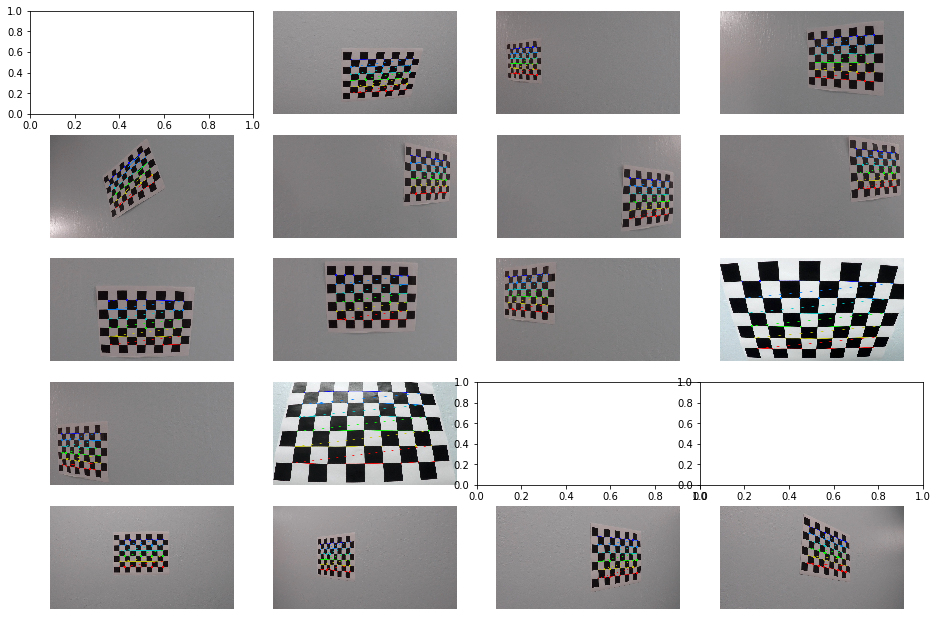

In [32]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list of images and search for chessboard corners in each one
for i, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points to the lists
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        axs[i].axis('off')
        axs[i].imshow(img)



*** Note that some of the images do not show because the chessboard corners were not found (ret == False).

### Use the object and image point lists from the chessboards above to calibrate the camera

In [33]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

In [34]:
print(ret)
print(mtx )
print(dist)
print(rvecs)

1.029815337105897
[[1.15777930e+03 0.00000000e+00 6.67111054e+02]
 [0.00000000e+00 1.15282291e+03 3.86128937e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
[[-0.24688775 -0.02373133 -0.00109842  0.00035108 -0.00258571]]
[array([[ 0.50881378],
       [-0.21913437],
       [ 0.02924913]]), array([[0.0340293 ],
       [0.45851593],
       [0.00531672]]), array([[0.03491911],
       [0.65175748],
       [0.00975282]]), array([[-0.33009144],
       [ 0.66083426],
       [-0.41563494]]), array([[ 0.05512564],
       [-0.5176842 ],
       [-0.00421231]]), array([[-0.02341591],
       [-0.48743707],
       [ 0.02025218]]), array([[ 0.03796005],
       [-0.46390767],
       [-0.0563429 ]]), array([[ 0.21392517],
       [-0.06380936],
       [ 0.0114793 ]]), array([[ 0.18015125],
       [-0.05108958],
       [-0.0011928 ]]), array([[0.08577053],
       [0.38442841],
       [0.05432207]]), array([[ 0.63303262],
       [-0.04811255],
       [ 0.01736398]]), array([[-0.02312285],
       [ 0.

In [35]:
print("Camera Matrix")
print(mtx)
print("Distortion Coeffs")
print(dist)

Camera Matrix
[[1.15777930e+03 0.00000000e+00 6.67111054e+02]
 [0.00000000e+00 1.15282291e+03 3.86128937e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Distortion Coeffs
[[-0.24688775 -0.02373133 -0.00109842  0.00035108 -0.00258571]]


# Image Distortion Correction

We can use the `cv2.undistort` function to undistort our images based on our camera calibration from above

Here's a helper function to do just that:

In [36]:
def undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

In [37]:
fname = './camera_cal/calibration1.jpg'

img = mpimg.imread(fname)

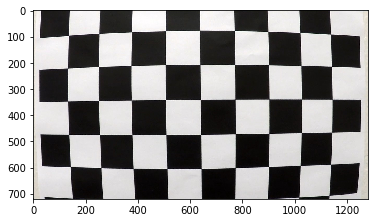

In [38]:
plt.imshow(img)

# Perspective Transform

In [39]:
def add_points(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = -1
    radius = 15
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.circle(img2, (x0, y0), radius, color, thickness)
    cv2.circle(img2, (x1, y1), radius, color, thickness)
    cv2.circle(img2, (x2, y2), radius, color, thickness)
    cv2.circle(img2, (x3, y3), radius, color, thickness)
    return img2

def add_lines(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = 2
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.line(img2, (x0, y0), (x1, y1), color, thickness)
    cv2.line(img2, (x1, y1), (x2, y2), color, thickness)
    cv2.line(img2, (x2, y2), (x3, y3), color, thickness)
    cv2.line(img2, (x3, y3), (x0, y0), color, thickness)
    return img2

In [40]:
h, w = img.shape[:2]

# Points for the original image
src = np.float32([
    [210, 700],
    [570, 460], 
    [705, 460], 
    [1075, 700]
])
# Points for the new image
dst = np.float32([
    [400, 720],
    [400, 0], 
    [w-400, 0], 
    [w-400, 720]
])


def warper(img):
    
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped

def unwarp(img):
    
    # Compute and apply inverse perpective transform
    img_size = (img.shape[1], img.shape[0])
    Minv = cv2.getPerspectiveTransform(dst, src)
    unwarped = cv2.warpPerspective(img, Minv, img_size, flags=cv2.INTER_NEAREST)
    
    return unwarped




## Test perspective on lines

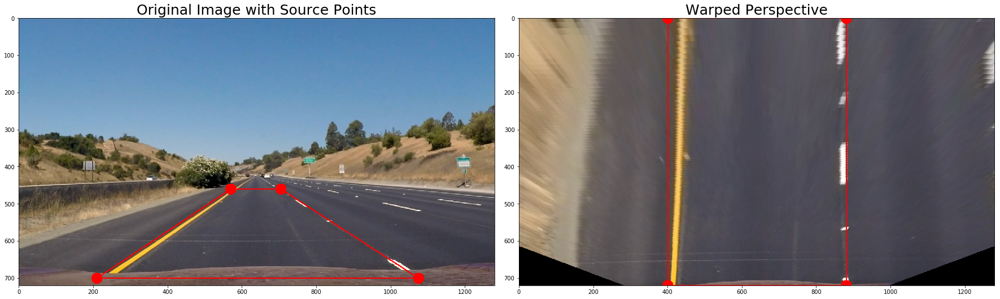

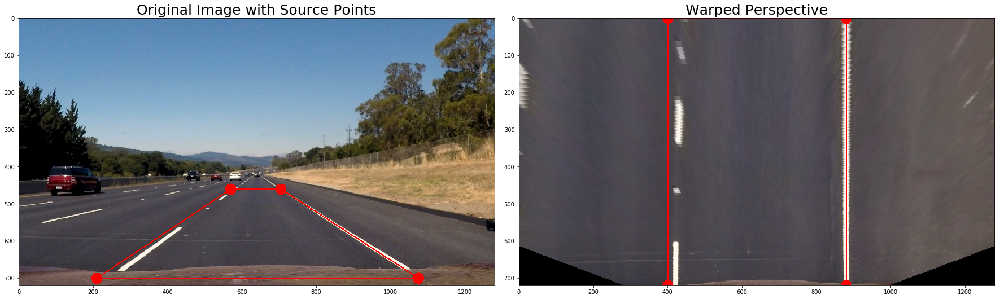

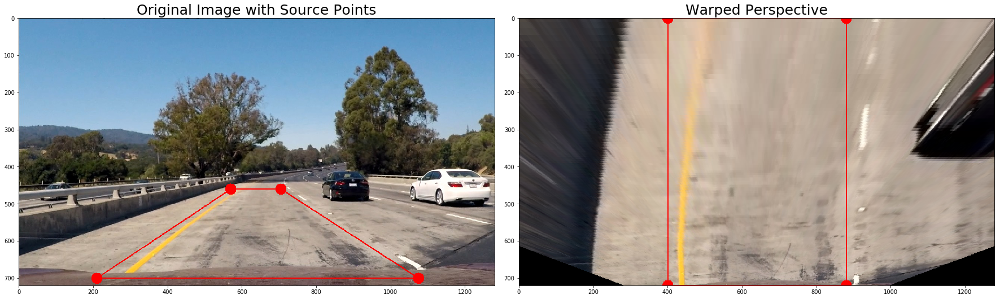

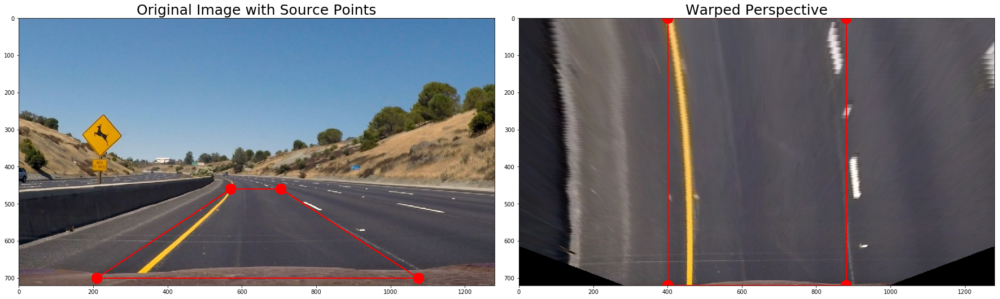

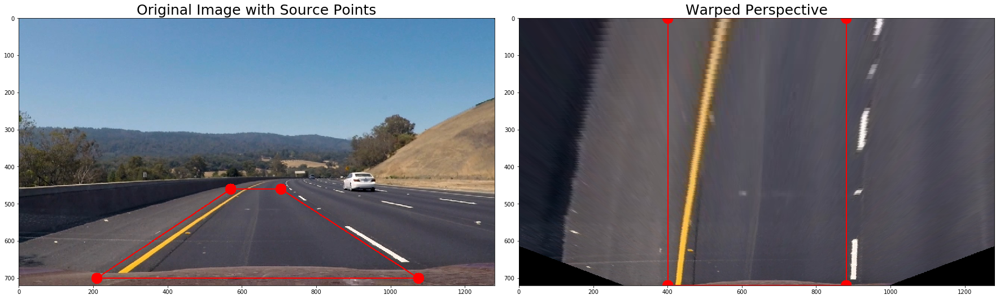

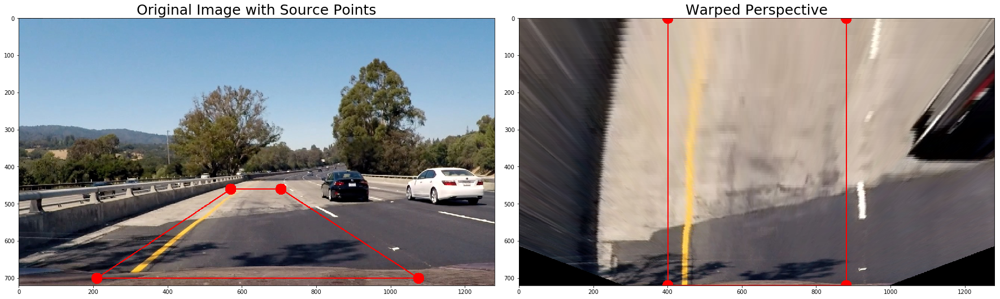

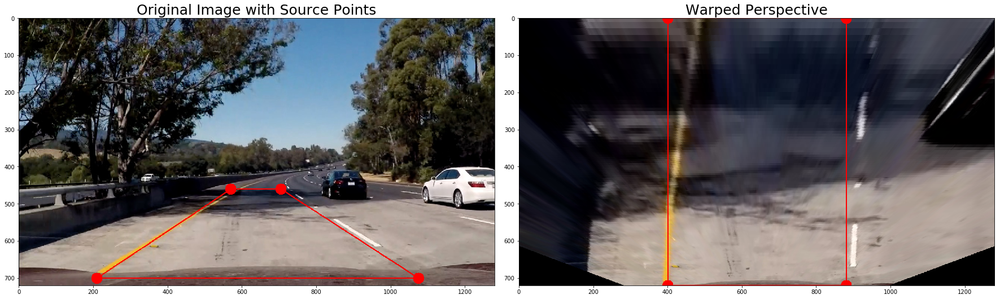

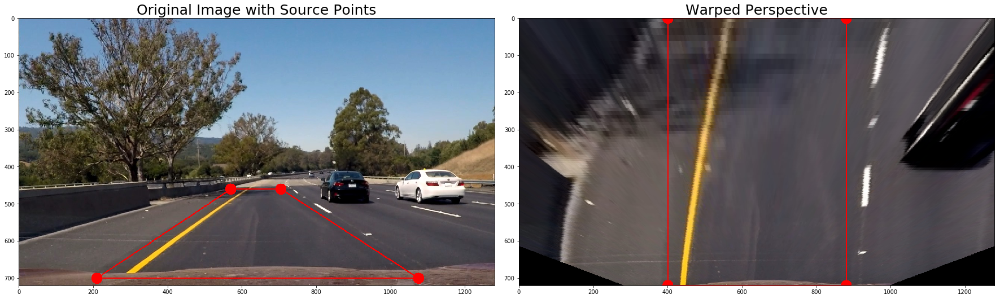

In [41]:
### get the straight test images from the test_images folder
### get the straight test images from the test_images folder
images = glob.glob('./test_images/*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    src_points_img = add_lines(src_points_img, src)
    dst_points_warped = add_points(warped, dst)
    dst_points_warped = add_lines(dst_points_warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Color selection

We can easily convert between color spaces using OpenCV. Using this, we can pull out the individual channels from each color space, and see if it better isolates the laneline pixels
rgb vecor = (red, green blue)


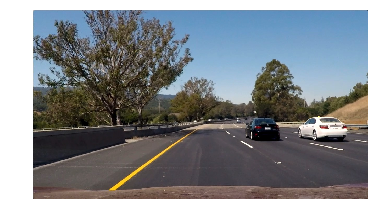

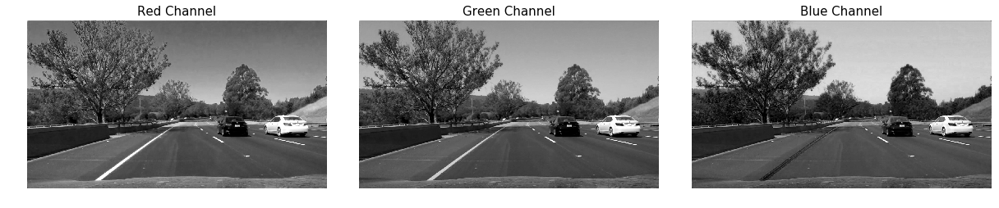

In [42]:
plt.imshow(img)
plt.axis('off')

R = img[:, :, 0]
G = img[:, :, 1]
B = img[:, :, 2]

f, ((ax1, ax2, ax3)) = plt.subplots(1, 3, figsize=(17, 14)) #
# Plot RGB
ax1.imshow(R, cmap='gray')
ax1.set_title('Red Channel', fontsize=15)
ax1.axis('off')
ax2.imshow(G, cmap='gray')
ax2.set_title('Green Channel', fontsize=15)
ax2.axis('off')
ax3.imshow(B, cmap='gray')
ax3.set_title('Blue Channel', fontsize=15)
ax3.axis('off')

plt.tight_layout()

### Color filter

Let's use white and yellow colors

In [43]:

def filter_Use_WhiteYellowColors(image):
    """
    Filter the image, showing only a range of white and yellow
    """
    # Filter White
    threshold = 200 # white threshold
    high_threshold = np.array([255, 255, 255]) #Bright white
    low_threshold = np.array([threshold, threshold, threshold]) #Soft White
    wmask = cv2.inRange(image, low_threshold, high_threshold)
    white_img = cv2.bitwise_and(image, image, mask=wmask)

    # Filter Yellow
    hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV) #Changing Color-space, HSV is better for object detection
    #hsv_img = np.copy(img)
    #For HSV, Hue range is [0,179], Saturation range is [0,255] and Value range is [0,255]. 
    high_threshold = np.array([110,255,255]) #Bright Yellow
    low_threshold = np.array([90,100,100]) #Soft Yellow   
    ymask = cv2.inRange(hsv_img, low_threshold, high_threshold)
    yellow_img = cv2.bitwise_and(image, image, mask=ymask)

    # Combine the two above images
    filtered_img = cv2.addWeighted(white_img, 1., yellow_img, 1., 0.)

    # Convert to black/white
    gray = cv2.cvtColor(filtered_img, cv2.COLOR_RGB2GRAY)
    binary_output2 = np.zeros_like(gray)
    binary_output2[(gray > 0)] = 1
    return binary_output2

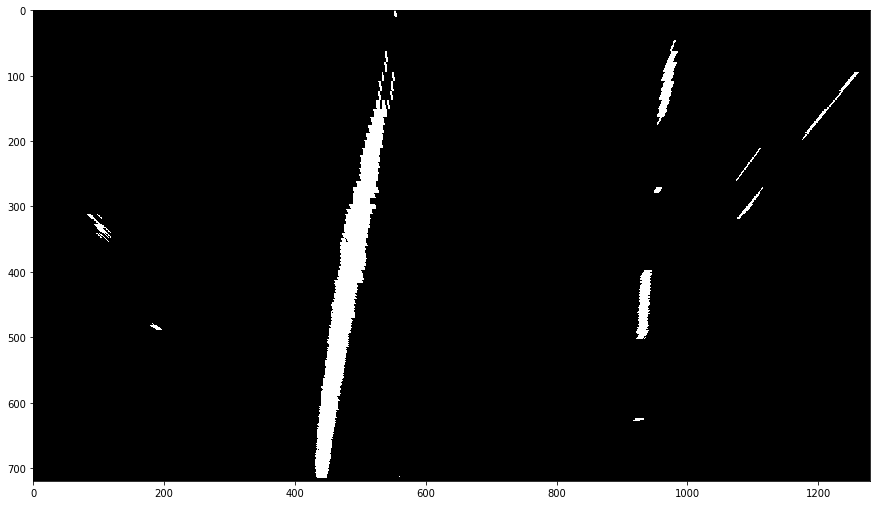

In [44]:
whiteyellow = filter_Use_WhiteYellowColors(image=img)
wrapedColor = warper(img=whiteyellow)
fig = plt.figure(figsize=(15, 12))
ax = fig.add_subplot(111)
ax.imshow(wrapedColor, cmap='gray')

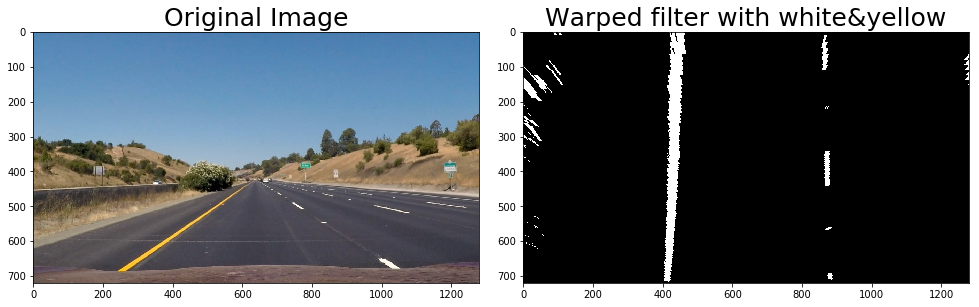

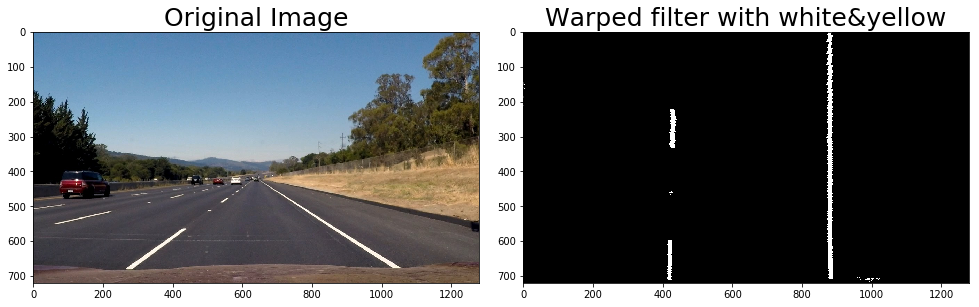

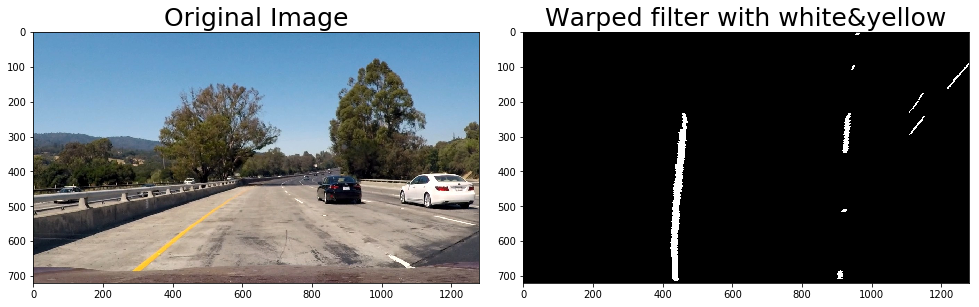

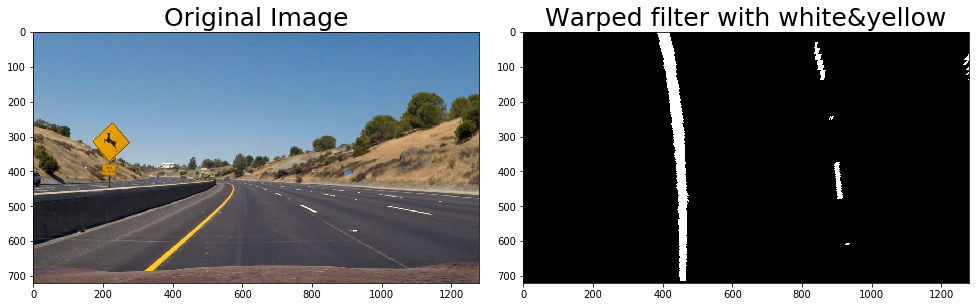

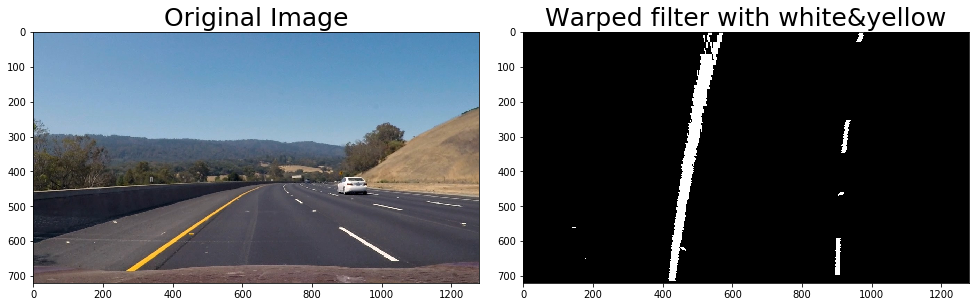

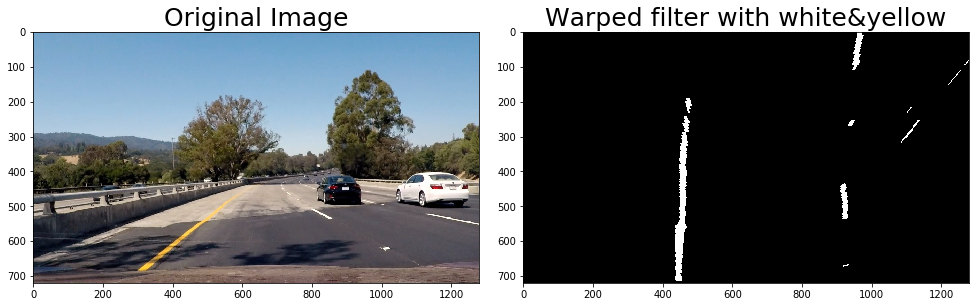

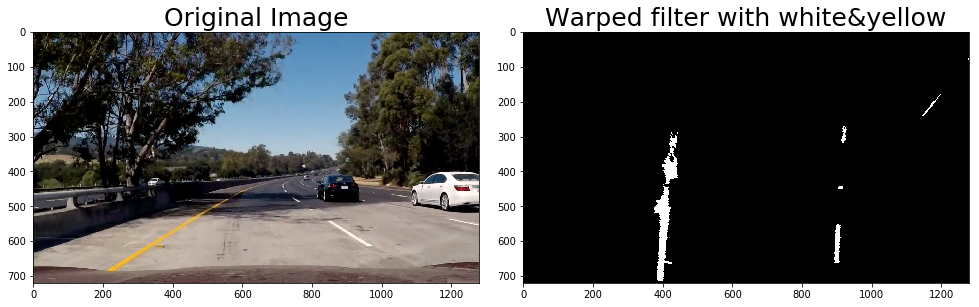

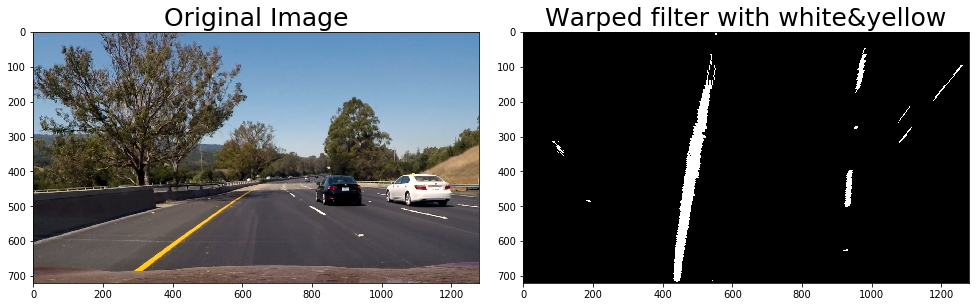

In [45]:
### Test on images
images = glob.glob('./test_images/*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    whiteyellow = filter_Use_WhiteYellowColors(image=img)
    wrapedColor = warper(img=whiteyellow)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 11))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(wrapedColor, cmap='gray')
    ax2.set_title('Warped filter with white&yellow', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

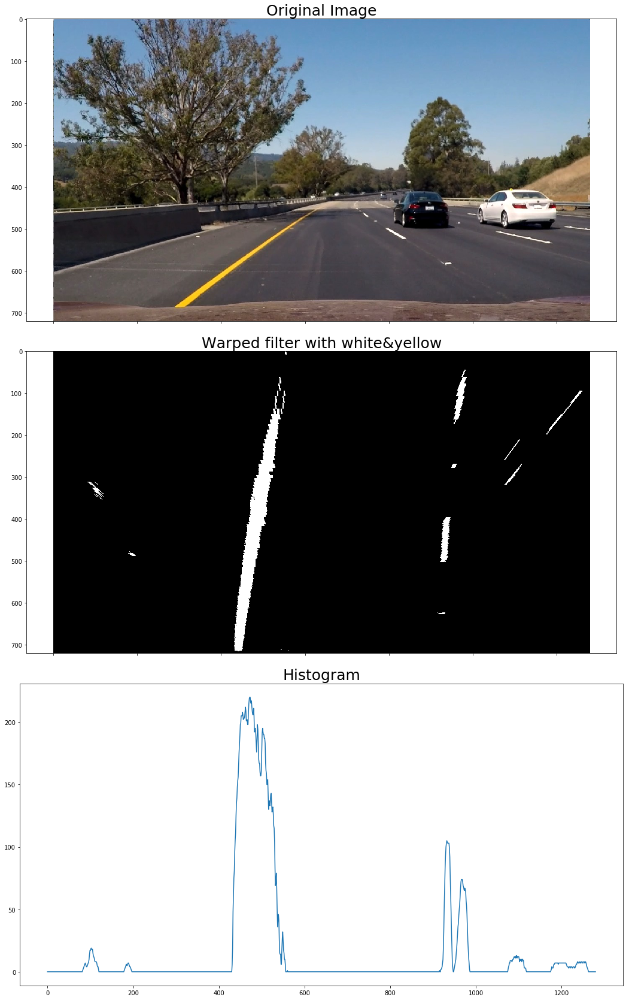

In [46]:
whiteyellow = filter_Use_WhiteYellowColors(image=img)
wrapedColor = warper(img=whiteyellow)

# Take a histogram of the bottom half of the image
histogram = np.sum(wrapedColor, axis=0)


f, (ax1, ax2, ax3) = plt.subplots(3, 1,  sharex=True, figsize=(14,3*8.3))
f.tight_layout()
f.subplots_adjust(hspace=0.1, wspace=0.05)
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=25)
ax2.imshow(wrapedColor, cmap='gray')
ax2.set_title('Warped filter with white&yellow', fontsize=25)

ax3.plot(histogram)
ax3.set_title('Histogram', fontsize=25)


plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



In [47]:
def sobelEdgeDetection(img, sx=False, sy=False, thresh=(25, 200)):
    # Convert to HSV for simpler calculations 
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    if sx:
        sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5))            
        # Scale to 8-bit (0 - 255) and convert to type = np.uint8
        scaled_sobel = np.uint8(255*sobelx/np.max(sobelx))
    if sy:
        sobely = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5))
        # Scale to 8-bit (0 - 255) and convert to type = np.uint8
        scaled_sobel = np.uint8(255*sobely/np.max(sobely))
    else:
        sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5))    
        sobely = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)) 
        #magnitude
        mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
        scaled_sobel = np.uint8(255*sobely/np.max(sobely))
    
    # Create a binary mask where mag thresholds are me
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1   

    return sxbinary
    

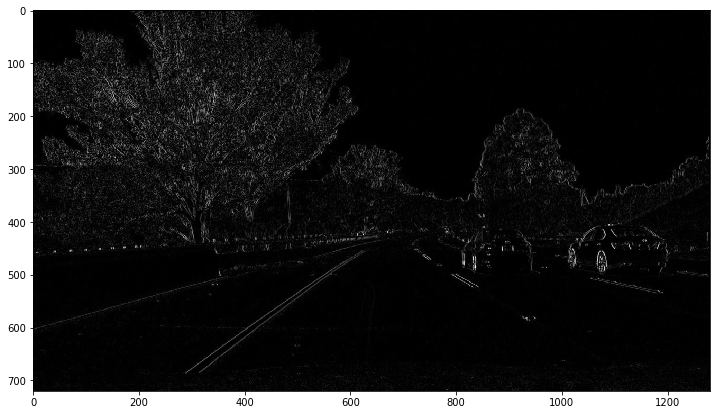

In [48]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=1))
sobelx = np.uint8(255*sobelx/np.max(sobelx))
plt.figure(figsize=(15, 7))
plt.imshow(sobelx, cmap='gray')

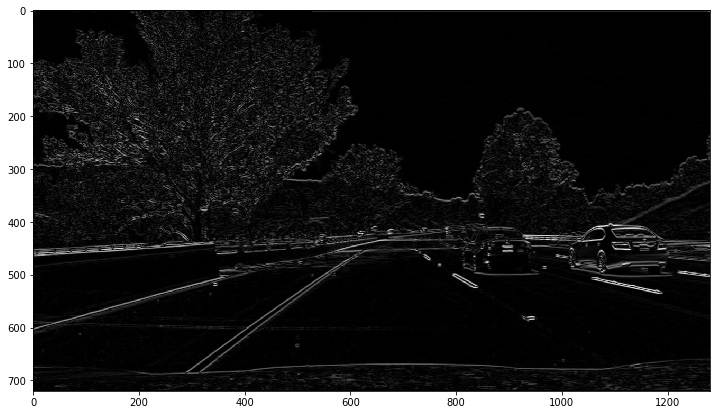

In [49]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5))

plt.figure(figsize=(15, 7))
plt.imshow(sobelx, cmap='gray')

In [50]:
# Canny edge detector

def cannyEdgeDetection(img, kernel_size=5, thresh=(25, 200)):
    
    #wrapedCanny = warper(img=img)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Apply a Gaussian Blur
    gausImage = cv2.GaussianBlur(gray, (kernel_size, kernel_size), 0)

    # Run the canny edge detection
    cannyImage = cv2.Canny(gray, thresh[0], thresh[1])
    cbinary = np.zeros_like(cannyImage)
    cbinary[(cannyImage > 0)] = 1

    return cbinary

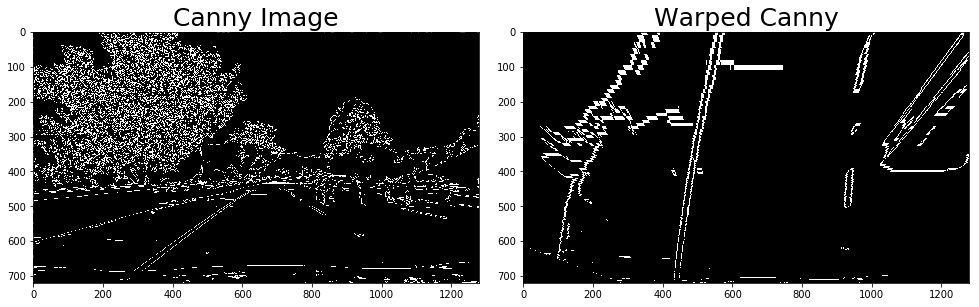

In [51]:
### Canny Edge Detection

cannyImg = cannyEdgeDetection(img=img, thresh=(50, 220))
wrapedCanny = warper(img=cannyImg)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 11))
f.tight_layout()
ax1.imshow(cannyImg, cmap='gray')
ax1.set_title('Canny Image', fontsize=25)
ax2.imshow(wrapedCanny, cmap='gray')
ax2.set_title('Warped Canny', fontsize=25)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

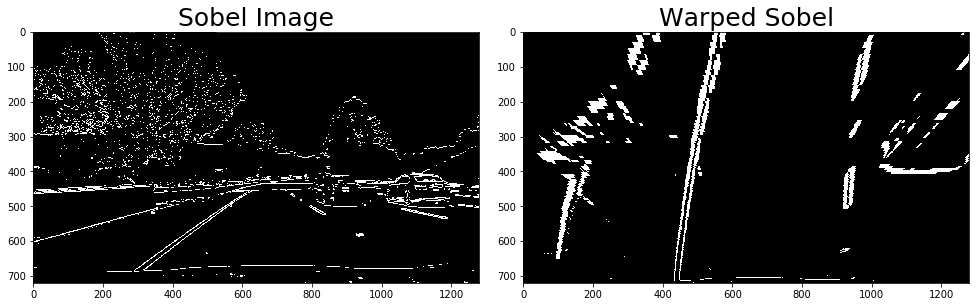

In [52]:
### Sobel Edge Detection

sobelImg = sobelEdgeDetection(img=img, sx=True, thresh=(50, 225))
wrapedSobel = warper(img=sobelImg)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 11))
f.tight_layout()
ax1.imshow(sobelImg, cmap='gray')
ax1.set_title('Sobel Image', fontsize=25)
ax2.imshow(wrapedSobel, cmap='gray')
ax2.set_title('Warped Sobel', fontsize=25)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [53]:
### Combine colors filter and Canny


def colorAndCanny(image, kernel_size=5, low_thresh=50, high_thresh=150):
    """
    Filter the image, showing only a range of white and yellow
    """
    # Filter White
    threshold = 200 # white threshold
    high_threshold = np.array([255, 255, 255]) #Bright white
    low_threshold = np.array([threshold, threshold, threshold]) #Soft White
    wmask = cv2.inRange(image, low_threshold, high_threshold)
    white_img = cv2.bitwise_and(image, image, mask=wmask)

    # Filter Yellow
    hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV) #Changing Color-space, HSV is better for object detection
    #hsv_img = np.copy(img)
    #For HSV, Hue range is [0,179], Saturation range is [0,255] and Value range is [0,255]. 
    high_threshold = np.array([110,255,255]) #Bright Yellow
    low_threshold = np.array([90,100,100]) #Soft Yellow   
    ymask = cv2.inRange(hsv_img, low_threshold, high_threshold)
    yellow_img = cv2.bitwise_and(image, image, mask=ymask)

    # Combine the two above images
    filtered_img = cv2.addWeighted(white_img, 1., yellow_img, 1., 0.)

    # Convert to black/white
    gray = cv2.cvtColor(filtered_img, cv2.COLOR_RGB2GRAY)
    binary_output2 = np.zeros_like(gray)
    binary_output2[(gray > 0)] = 255
    
    # Apply a Gaussian Blur
    #gausImage = cv2.GaussianBlur(binary_output2, (kernel_size, kernel_size), 0)

    # Run the canny edge detection
    cannyImage = cv2.Canny(binary_output2, low_thresh, high_thresh)
    return cannyImage


def color_sodeOrCanny(color, sobelCanny):
    comb = np.zeros_like(sobelCanny)
    comb[(color == 1) | (sobelCanny == 1)] = 1

    return comb


def compare_images(image1, image2, image1_exp="Image 1", image2_exp="Image 2"):
    
    wrapedIm = warper(img=image2)
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image1)
    ax1.set_title(image1_exp, fontsize=30)
    ax2.imshow(image2, cmap='gray')
    ax2.set_title(image2_exp, fontsize=30)
    ax3.imshow(wrapedIm, cmap='gray')
    ax3.set_title("Wraped", fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    
def binaryPipline(img):
    whiteyellow = filter_Use_WhiteYellowColors(image=img)
    sobelImg = sobelEdgeDetection(img=img, thresh=(150, 225))
    colorSobel = color_sodeOrCanny(color=whiteyellow, sobelCanny=sobelImg)
    #compare_images(img, colorSobel, "Original", "ColorSobel")
    return colorSobel

In [54]:
whiteyellow = filter_Use_WhiteYellowColors(image=img)
sobelImg = sobelEdgeDetection(img=img, thresh=(150, 225))
cannyImg = cannyEdgeDetection(img=img, thresh=(150, 255))

In [55]:
colorSobel = color_sodeOrCanny(color=whiteyellow, sobelCanny=sobelImg)
colorCanny = color_sodeOrCanny(color=whiteyellow, sobelCanny=cannyImg)

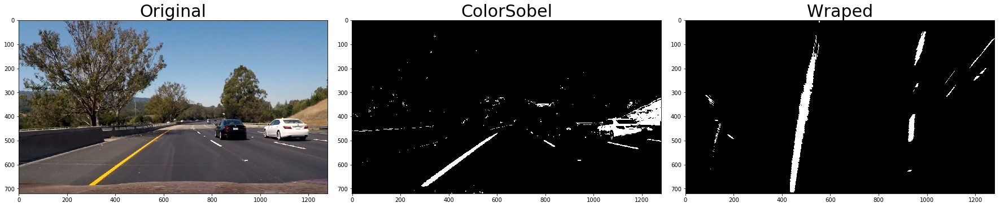

In [56]:
compare_images(img, colorSobel, "Original", "ColorSobel")

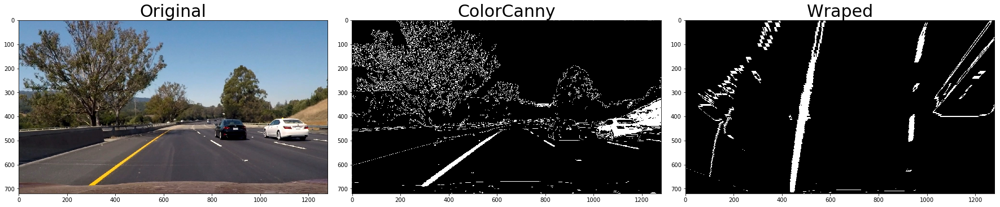

In [57]:
compare_images(img, colorCanny, "Original", "ColorCanny")

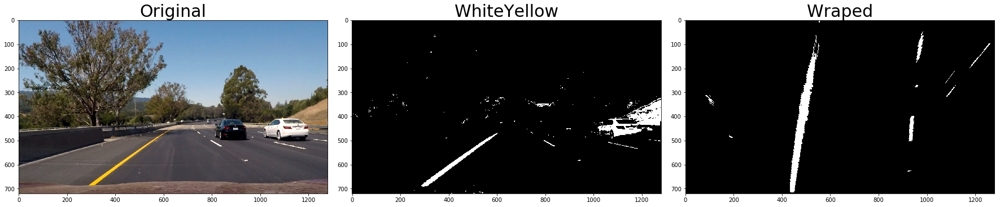

In [58]:
compare_images(img, whiteyellow, "Original", "WhiteYellow")

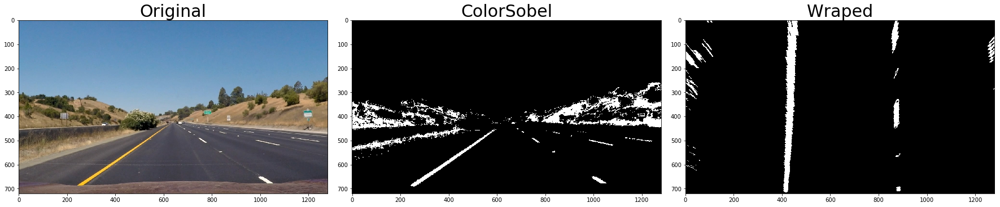

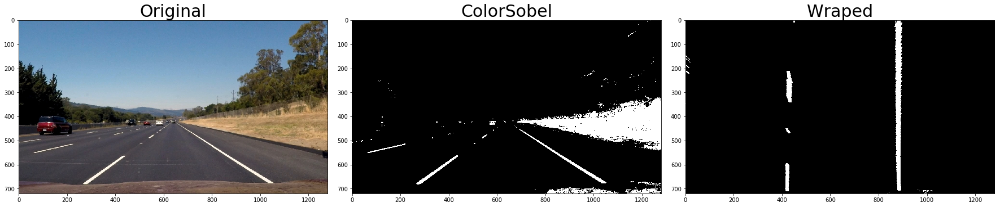

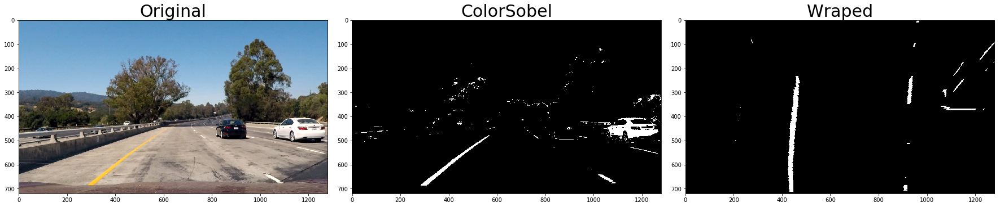

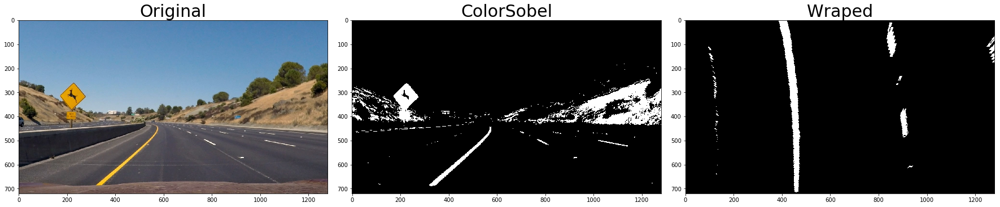

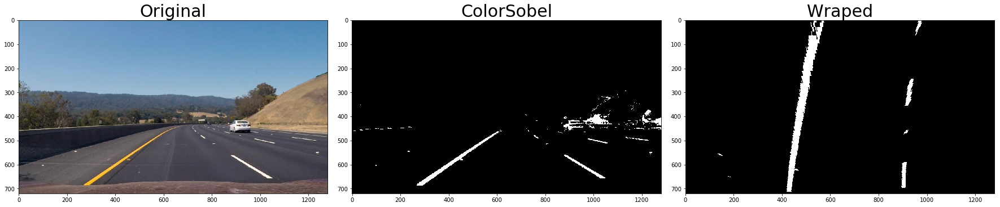

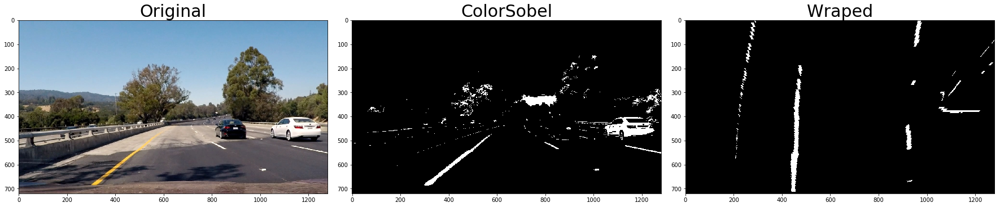

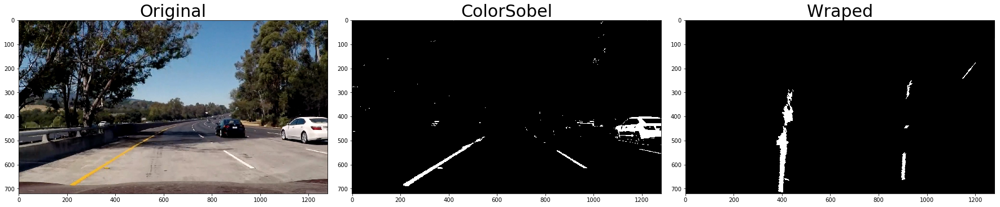

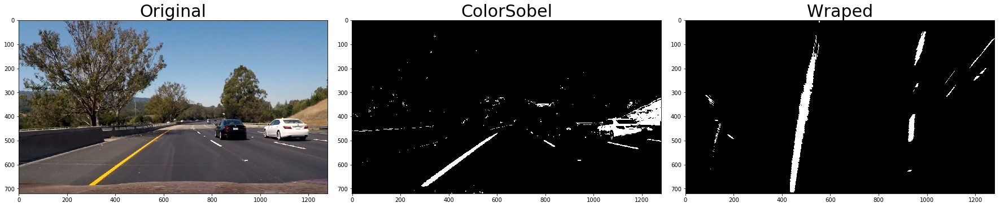

In [59]:
### Test on testeed img

### Test on images
images = glob.glob('./test_images/*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    dbinPip = binaryPipline(img=img)
    compare_images(img, dbinPip, "Original", "ColorSobel")

In [60]:

ym_per_pix = 3*8/720 # meters per pixel in y dimension, 8 lines (5 spaces, 3 lines) at 10 ft each = 3m
xm_per_pix = 3.7/550 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters

def calc_line_fits(img):

    ### Settings
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50


    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)

    #plt.figure()
    #plt.plot(histogram)
    
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        #print(window)
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        #print((win_xleft_low,win_y_low),(win_xleft_high,win_y_high))
        cv2.rectangle(img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        #cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low)
                          & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) 
                           & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    #print("Windows done!")
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    #print(lefty)
    #print(leftx)
    #print(righty)
    #print(rightx)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return left_fit, right_fit, left_fit_m, right_fit_m, out_img

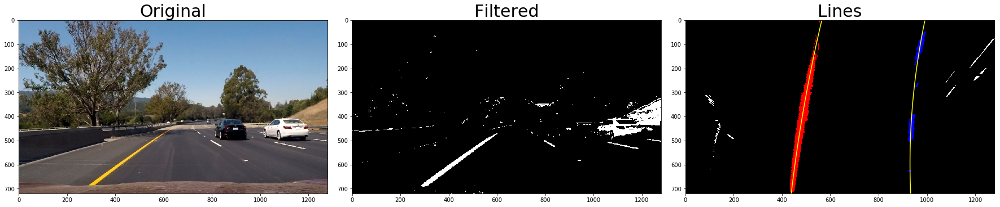

In [61]:
origImg = mpimg.imread(fname)

#whiteyellow = filter_Use_WhiteYellowColors(image=origImg)
binpipeline=binaryPipline(img=origImg)
img2 = warper(img=np.copy(binpipeline))
left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(img=np.copy(img2))


ploty = np.linspace(0, wrapedColor.shape[0]-1, wrapedColor.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(origImg)
ax1.set_title("Original", fontsize=30)
ax2.imshow(binpipeline, cmap='gray')
ax2.set_title("Filtered", fontsize=30)
ax3.imshow(out_img, cmap='gray')
ax3.plot(left_fitx, ploty, c="yellow")
ax3.plot(right_fitx, ploty, c="yellow")
ax3.set_title("Lines", fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [62]:
def applyLinesDetection(img, binpipeline, left_fit, right_fit):
    #left_fit = left_fit
    #right_fit = right_fit
    bimPipeWrap = warper(img=np.copy(binpipeline))

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(bimPipeWrap).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Generate x and y values for plotting
    ploty = np.linspace(0, bimPipeWrap.shape[0]-1, bimPipeWrap.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp)

    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)

    return result

def calc_line_fits_from_prev(img, leftLine, rightLine):

    left_fit = leftLine.best_fit_px
    right_fit = rightLine.best_fit_px
    
    ### Settings
    margin = 100 # Width on either side of the fitted line to search

    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                      (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                       (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin))) 
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each in meters
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binpipeline.shape[0]-1, binpipeline.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binpipeline, binpipeline, binpipeline))*255
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return left_fit, right_fit, left_fit_m, right_fit_m, result

In [63]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        
        # was the line detected in the last iteration?
        self.detected = False  
        
        # polynomial coefficients averaged over the last n iterations
        self.best_fit_px = None
        self.best_fit_m = None
        
        #polynomial coefficients for the most recent fit
        self.current_fit_px = []  
        self.current_fit_m = []
        
        #radius of curvature of the line in some units
        self.radius_of_curvature = None
        
        # center position of car
        self.lane_to_camera = None
        
        # Previous Fits
        self.previous_fits_px = []
        self.previous_fits_m = []
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        
        # meters per pixel in y dimension
        self.ym_per_pix = 30/720
        
        # y_eval is where we want to evaluate the fits for the line radius calcuation 
        # for us it's at the bottom of the image for us, and because we know 
        # the size of our video/images we can just hardcode it
        self.y_eval = 720. * self.ym_per_pix
        
        # camera position is where the camera is located relative to the image
        # we're assuming it's in the middle
        self.camera_position = 640.

    def run_line_pipe(self):
        self.calc_best_fit()
        #self.calc_radius()
        
    def add_new_fit(self, new_fit_px, new_fit_m):
        """
        Add a new fit to the Line class
        """
        
        # If this is our first line, then we will have to take it
        #print("Lines()")
        #print(self.current_fit_px)
        #print(self.previous_fits_px )
        #print(type(self.current_fit_px))
        #print(type(self.previous_fits_px ))
        #print("End Lines()")
        if (len(self.current_fit_px) == 0) and (len(self.previous_fits_px) == 0):
            self.detected = True
            self.current_fit_px = new_fit_px
            self.current_fit_m = new_fit_m
            self.run_line_pipe()
            return
        else:
            # measure the diff to the old fit
            self.diffs = np.abs(new_fit_px - self.current_fit_px)
            # check the size of the diff
            if self.diff_check():
                print("Found a fit diff that was too big")
                print(self.diffs)
                self.defected = False
                return
            self.detected = True
            self.current_fit_px = new_fit_px
            self.current_fit_m = new_fit_m
            self.run_line_pipe()
            return

            
    def diff_check(self):
        if self.diffs[0] > 0.001:
            return True
        if self.diffs[1] > 0.25:
            return True
        if self.diffs[2] > 1000.:
            return True
        return False

    def calc_best_fit(self):
        """
        calculate the average, if needed
        """
        # add the latest fit to the previous fit list
        self.previous_fits_px.append(self.current_fit_px)
        self.previous_fits_m.append(self.current_fit_m)
        
        # If we currently have 5 fits, throw the oldest out
        if len(self.previous_fits_px) > 5:
            self.previous_fits_px = self.previous_fits_px[1:]
        if len(self.previous_fits_m) > 5:
            self.previous_fits_m = self.previous_fits_m[1:]
        
        # Just average everything
        self.best_fit_px = np.average(self.previous_fits_px, axis=0)
        self.best_fit_m = np.average(self.previous_fits_m, axis=0)
        return
        
        
    def calc_radius(self):
        """
        left_fit and right_fit are assumed to have already been converted to meters
        """
        y_eval = self.y_eval
        fit = self.best_fit_m

        curve_rad = ((1 + (2*fit[0]*y_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
        self.radius_of_curvature = curve_rad
        return
        

In [64]:
def main(img):

    #whiteyellow = filter_Use_WhiteYellowColors(image=origImg)
    binpipeline=binaryPipline(img=img)
    img2 = warper(img=np.copy(binpipeline))
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(img=np.copy(img2))
    
    result = applyLinesDetection(img=img, binpipeline=binpipeline, left_fit=left_fit, right_fit=right_fit)
    return result

In [65]:
def main2(img):

    #whiteyellow = filter_Use_WhiteYellowColors(image=origImg)
    binpipeline=binaryPipline(img=img)
    img2 = warper(img=np.copy(binpipeline))
    #left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(img=np.copy(img2))
    
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(np.copy(img2))
        
    # If we found lines previously, run the simplified line fitter
    #if leftLine.detected == True and rightLine.detected == True:
    #    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits_from_prev(np.copy(img2), leftLine, rightLine)
    #else:
    # Run the warped, binary image from the pipeline through the complex fitter
    #    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(np.copy(img2))
        
    #print("From main:")
    #print(left_fit, left_fit_m)
    #print(right_fit, right_fit_m)
    #print("From main end")
    # Add these fits to the line classes
    leftLine.add_new_fit(left_fit, left_fit_m)
    rightLine.add_new_fit(right_fit, right_fit_m)
    
    result = applyLinesDetection(img=img, binpipeline=binpipeline, left_fit=left_fit, right_fit=right_fit)
    return result

./test_images\straight_lines1.jpg
./test_images\straight_lines2.jpg
./test_images\test1.jpg
./test_images\test2.jpg
./test_images\test3.jpg
./test_images\test4.jpg
./test_images\test5.jpg
./test_images\test6.jpg


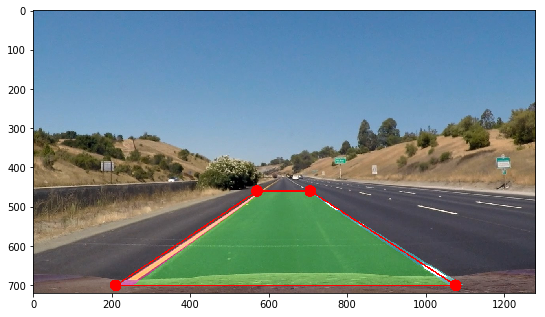

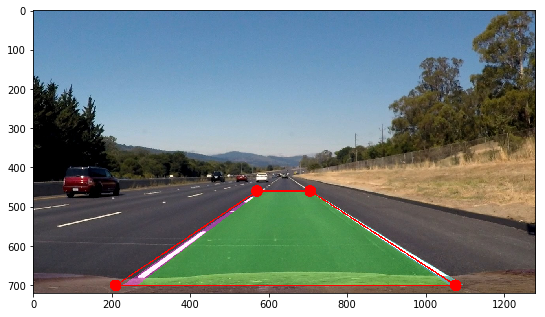

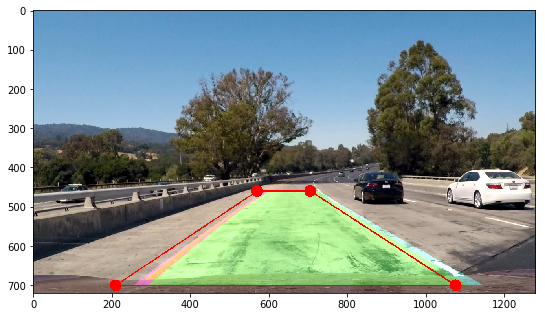

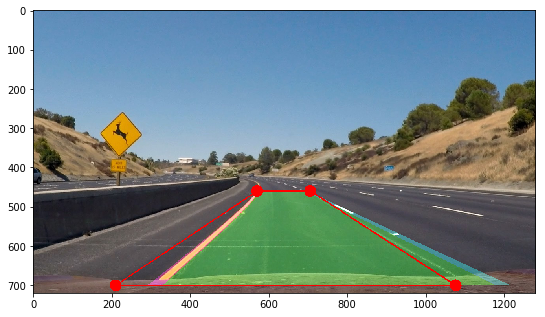

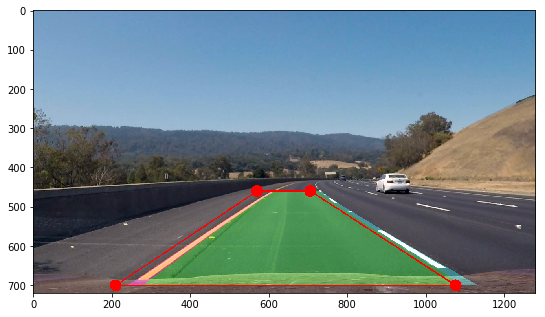

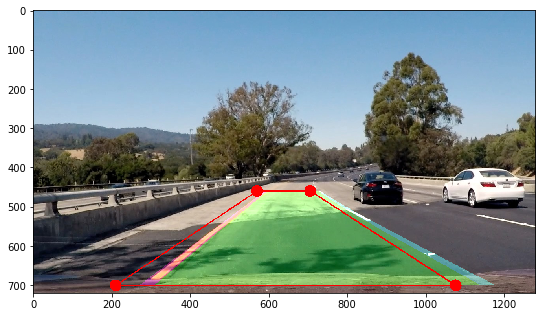

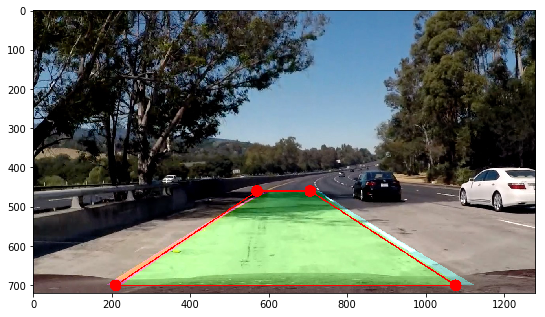

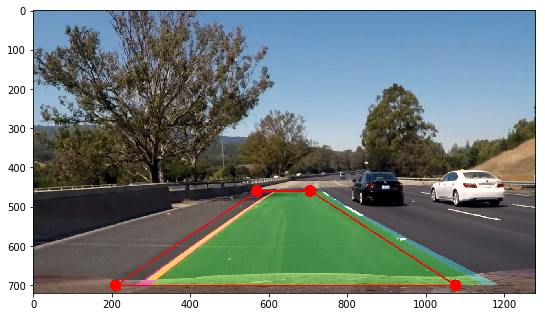

In [66]:
images = glob.glob('./test_images/*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    # Initialize two lines for left and right on every image since the images don't
    # come from a continous video
    #rightLine = Line()
    #leftLine = Line()
    
    # Read the image
    print(fname)
    origImg = mpimg.imread(fname)

    #whiteyellow = filter_Use_WhiteYellowColors(image=origImg)
    binpipeline=binaryPipline(img=origImg)
    img2 = warper(img=np.copy(binpipeline))
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(img=np.copy(img2))
    
    # Run the image through the pipeline
    result = applyLinesDetection(img=origImg, binpipeline=binpipeline, left_fit=left_fit, right_fit=right_fit)
    result = add_points(img=result, src=src)
    result = add_lines(img=result, src=src)

    # Let's plot the image
    plt.figure(figsize=(9,9))
    plt.imshow(result)

In [67]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from moviepy.editor import ipython_display

pygame 1.9.4
Hello from the pygame community. https://www.pygame.org/contribute.html


In [68]:
#cap = cv2.VideoCapture("test_video/test_video.mp4")
#while (cap.isOpened()):
#    try:
#        _, frame = cap.read()
#        result = main(img=np.copy(frame))
#        cv2.imshow('result', result)
#        if cv2.waitKey(10) == ord("q"):
#            break
#    except Exception as e:
#        print(e)
#cap.release()
#cv2.destroyAllWindows()

In [69]:
leftLine = Line()
rightLine = Line()

output = 'output_video/test_video_output.mp4'
clip1 = VideoFileClip("test_video/test_video.mp4")
clip1.reader.close()
clip1.audio.reader.close_proc()
clip = clip1.fl_image(main2)

%time clip.write_videofile(output, audio=False)

Moviepy - Building video output_video/test_video_output.mp4.
Moviepy - Writing video output_video/test_video_output.mp4



Moviepy - Done !
Moviepy - video ready output_video/test_video_output.mp4
Wall time: 4min 44s


In [70]:
clip1.reader.close()
clip1.audio.reader.close_proc()